In [14]:
#import json
import csv
import numpy as np
import matplotlib.pyplot as plt
#from pycocotools.coco import COCO
import pandas as pd
#import random
from PIL import Image, ImageDraw, ImageFont, ExifTags
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.patches as patches
from matplotlib.pyplot import figure
from shapely.geometry import Polygon
import pylab
pylab.rcParams['figure.figsize'] = (8.0, 10.0)
import cv2
import os
# import datetime
# import torch
# import torchvision
from sklearn.model_selection import train_test_split
import os
from pathlib import Path
#import yaml
import time
#import psycopg2
from datetime import datetime

import numpy as np
from sklearn.model_selection import train_test_split
import pandas as pd
import cv2

from matplotlib import image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.patches import Rectangle
from PIL import Image, ImageDraw, ImageFont, ExifTags
import time

### Fonctions Utils

In [2]:
def build_yolo_annotations_for_images(data_dir, images_dir, df_bboxes,
                                      df_images, limit_data, exclude_ids=None):
    """ Generates the .txt files that are necessary for yolo training. See
    https://github.com/ultralytics/yolov5/wiki/Train-Custom-Data for data format
    Args:
        data_dir: path of the root data dir. It should contain an
        images folder with all images.
        raw_annotations, raw_images_info, raw_category_info: extracts from
        the database
    Returns:
        the list of images path that will be used in training
    """
    valid_imagenames = []

    input_img_folder = Path(images_dir)
    data_dir = Path(data_dir)
    list_imgs = sorted(os.listdir(input_img_folder))
    used_imgs = set(df_bboxes["id_ref_images_for_labelling"].values)

    print(f"number of images in images folder: {len(list_imgs)}")
    print(f"number of images referenced in database: {len(df_images)}")
    print(f"number of images with a bbox in database: {len(used_imgs)}")
    if exclude_ids:
        used_imgs = used_imgs - exclude_ids
        print(f"after exclusion, number of images with a bbox in database: {len(used_imgs)}")

    if not Path.exists(data_dir / "images"):
        os.mkdir(data_dir / "images")
    if not Path.exists(data_dir / "labels"):
        os.mkdir(data_dir / "labels")


    count_exists, count_missing = 0, 0

    for img_id in used_imgs:
        img_name = df_images.loc[img_id]["filename"]
        if Path.exists(input_img_folder / img_name):
            count_exists += 1
            if limit_data > 0 and count_exists > limit_data:
                break
            # various meta information about the image, could be useful
            date_creation  = df_images.loc[img_id]["createdon"]
            view           = df_images.loc[img_id]["view"]
            image_quality  = df_images.loc[img_id]["image_quality"]
            context        = df_images.loc[img_id]["context"]
            date_time_obj = time.strptime(date_creation, '%Y-%m-%d %H:%M:%S.%f')

            image = Image.open(input_img_folder / img_name)

            # in place rotation of the image using Exif data
            try :
                image = image_orientation(image)
            except:
                pass

            image    = np.array(image)
            h, w     = image.shape[:-1]
            target_h = 1080 # the target height of the image
            ratio    = target_h / h # We get the ratio of the target and the actual height
            target_w = int(ratio*w)
            image    = cv2.resize(image, (target_w, target_h))
            h, w     = image.shape[:-1]

            # getting annotations and converting to yolo
            anns = df_bboxes[df_bboxes["id_ref_images_for_labelling"] == img_id]
            labels, bboxes = process_annotations(anns, ratio, target_h, target_w)
            yolo_strs = [str(cat) + " " + " ".join(bbox.astype(str)) for (cat, bbox) in zip(labels, bboxes)]

            # writing the image and annotation
            img_file_name   = data_dir / "images" / (img_id + ".jpg")
            label_file_name = data_dir / "labels" / (img_id + ".txt")
            Image.fromarray(image).save(img_file_name)
            with open(label_file_name, 'w') as f:
                f.write('\n'.join(yolo_strs))

            valid_imagenames.append(img_file_name.as_posix())
        else:
            count_missing +=1

        if count_exists%500==0:
            print("Exists : ", count_exists)
            print("Missing : ",count_missing)
            
    return valid_imagenames, count_exists, count_missing

In [3]:
def get_annotations_from_files(input_dir, bbox_filename, images_filename):
    """ Get annotations from csv files instead of the database. The files should
    be located in the input_dir folder
    """
    df_bboxes = pd.read_csv(input_dir / bbox_filename)
    df_images = pd.read_csv(input_dir / images_filename).set_index("id")
    return df_bboxes, df_images

In [4]:
def process_annotations(anns, ratio, target_h, target_w):
    """ Processes the annotations to match the yolo format
    """
    labels = anns["id_ref_trash_type_fk"].values - 1
    bboxes = anns[["location_x","location_y","width","height"]].values * ratio
    bboxes = bbox2yolo(bboxes, target_h, target_w)
    return labels, bboxes

In [5]:
def bbox2yolo(bbox, image_height, image_width):
    """Function to normalize the representation of the bounding box, such that
    there are in the yolo format (normalized in range [0-1])
    Args:
        bbox (list): Coordinates of the bounding box : x, y, w and h coordiates.
        image_height (int, optional): Height of the image. Defaults to 1080.
        image_width (int, optional): Width of the image. Defaults to 1080.
    Returns: Normalized bounding box coordinates : values between 0-1.
        _type_: array
    """
    bbox = bbox.copy().astype(float) #instead of np.int

    bbox[:, [0, 2]] = bbox[:, [0, 2]]/ image_width
    bbox[:, [1, 3]] = bbox[:, [1, 3]]/ image_height

    bbox[:, [0, 1]] = bbox[:, [0, 1]] + bbox[:, [2, 3]]/2

    return bbox

In [6]:
def image_orientation (image):
    """ Function which gives the images that have a specified orientation the same orientation.
        If the image does not have an orientation, the image is not altered.
     Args:
        image (image): Image that is in the path data_directory as well as in the instance json files.
    Returns: Image, with the proper orientation.
            _type_: image
    """
    
    for orientation in ExifTags.TAGS.keys():
        if ExifTags.TAGS[orientation]=='Orientation':
            break
    exif = image._getexif()

    if exif is not None:
        if exif[orientation] == 3:
            image=image.rotate(180, expand=True)
        elif exif[orientation] == 6:
            image=image.rotate(270, expand=True)
        elif exif[orientation] == 8:
            image=image.rotate(90, expand=True)

    return image

In [7]:
class_id_to_name_mapping = {1: 'Insulating material',
 4: 'Drum',
 2: 'Bottle-shaped',
 3: 'Can-shaped',
 5: 'Other packaging',
 6: 'Tire',
 7: 'Fishing net / cord',
 8: 'Easily namable',
 9: 'Unclear',
 0: 'Sheet / tarp / plastic bag / fragment'}

In [8]:
def plot_image_an_bboxes_yolo(image, annotation_list):
    annotations = np.array(annotation_list)
    w, h = image.size
    
    plotted_image = ImageDraw.Draw(image)

    transformed_annotations = np.copy(annotations)
    transformed_annotations[:,[1,3]] = annotations[:,[1,3]] * w
    transformed_annotations[:,[2,4]] = annotations[:,[2,4]] * h 
    
    transformed_annotations[:,1] = transformed_annotations[:,1] - (transformed_annotations[:,3] / 2)
    transformed_annotations[:,2] = transformed_annotations[:,2] - (transformed_annotations[:,4] / 2)
    transformed_annotations[:,3] = transformed_annotations[:,1] + transformed_annotations[:,3]
    transformed_annotations[:,4] = transformed_annotations[:,2] + transformed_annotations[:,4]
    
    for ann in transformed_annotations:
        obj_cls, x0, y0, x1, y1 = ann
        plotted_image.rectangle(((x0,y0), (x1,y1)), outline="#ff8300", width=5)
        
        plotted_image.text((x0, y0 - 10), class_id_to_name_mapping[(int(obj_cls))])
    
    plt.figure(figsize = (12,10))
    plt.imshow(np.array(image))
    plt.show()

### Data and Imports

In [22]:
from argparse import Namespace
args = Namespace(
    data_dir="c:/Users/packo/Documents/Projets/surfrider/yolov5_train_test/notebooks",
    images_dir="c:/Users/packo/Documents/Projets/surfrider/yolov5_train_test/notebooks/images2label",
    bbox_filename="csv/bounding_boxes_202206171635.csv",
    images_filename="csv/images_for_labelling_202206171635.csv",
    limit_data=0
)

In [23]:
df_bboxes, df_images = get_annotations_from_files(Path(args.data_dir),args.bbox_filename,args.images_filename)

In [24]:
df_bboxes.head()

,id,id_creator_fk,createdon,id_ref_trash_type_fk,id_ref_images_for_labelling,location_x,location_y,width,height
0,47ff3b15-dc95-4efa-ad3d-b6963db3ef16,954dfaf0-cf84-4e5d-ad9d-0d0d6badb884,2021-06-03 14:10:37.182,10,744093fe-3112-4577-abf9-6ec24fa1d66e,1934,1284,234,239
1,94164dac-8b99-4fa3-9309-cd6ccbbe855e,954dfaf0-cf84-4e5d-ad9d-0d0d6badb884,2021-06-03 15:35:30.492,10,9711e35b-67c3-4e76-a5e3-2f7a7204be79,1489,2330,152,162
2,87bcd5d8-c2ac-472e-acd6-8114dcfe5a4a,954dfaf0-cf84-4e5d-ad9d-0d0d6badb884,2021-06-03 15:37:31.548,1,3bf07139-1e2a-4bba-83ea-86a964e26f05,4033,2026,480,392
3,f52af6e9-15c4-4916-8f4f-3ffda09ada98,954dfaf0-cf84-4e5d-ad9d-0d0d6badb884,2021-06-03 15:41:04.706,1,b910e724-2a08-4dc7-ab2b-52276b7d9aed,2053,1304,143,167
4,7106288f-7cfd-4f73-9771-6a6b838e5460,954dfaf0-cf84-4e5d-ad9d-0d0d6badb884,2021-06-03 15:43:53.532,3,36267cf1-891c-4b72-857d-802fa2a3fd04,1603,1431,247,284


In [25]:
df_bboxes.shape

(11215, 9)

In [26]:
df_images.head()

,id_creator_fk,createdon,filename,view,image_quality,context,container_url,blob_name
id,,,,,,,,
774ea7c1-e8ed-4fae-81fd-784c3ce87365,91f946b6-8871-4fbb-8c00-1b6794efb610,2021-05-19 08:56:51.809,04a90fd6-dbe8-4e35-bc8e-8bdea63bb77d.jpg,NaN,NaN,NaN,https://dataplasticoprod.blob.core.windows.net...,NaN
5ec8e4a4-d2e9-4d03-99ed-12e2744ca5ae,954dfaf0-cf84-4e5d-ad9d-0d0d6badb884,2021-05-27 12:15:17.409,img3316.jpg,side,good,river,NaN,NaN
4aa4b452-ce49-4578-a71b-39d99c305e59,954dfaf0-cf84-4e5d-ad9d-0d0d6badb884,2021-05-27 12:15:40.239,img630.jpg,above,good,river,NaN,NaN
ed5d193b-c897-4ebb-9d2d-e1583653923e,954dfaf0-cf84-4e5d-ad9d-0d0d6badb884,2021-05-27 12:14:53.892,img2387.jpg,side,good,river,NaN,NaN
f76656ed-bd4c-4672-b2c0-bc7ddaba2ba3,954dfaf0-cf84-4e5d-ad9d-0d0d6badb884,2021-05-27 12:14:59.798,img2611.jpg,side,medium,river,NaN,NaN


In [27]:
df_images.shape

(7484, 8)

### (Prep and Train)

In [13]:
# yolo_filelist, cpos, cneg = build_yolo_annotations_for_images(args.data_dir, args.images_dir,df_bboxes, df_images, args.limit_data)

number of images in images folder: 7541
number of images referenced in database: 7484
number of images with a bbox in database: 6161


In [10]:
# def get_train_valid(list_files, split=0.85):
#     """ split data into train and test
#     """
#     train_files, val_files = train_test_split(list_files, train_size = split)
#     train_files = list(set(train_files))
#     val_files   = list(set(val_files))

#     return train_files, val_files

In [95]:
# train_files, val_files = get_train_valid(yolo_filelist)

### (Test Plot Image)

In [41]:
row_index = 1
name_test_img = df_images.iloc[row_index]["filename"]
name_test_img 

'img3316.jpg'

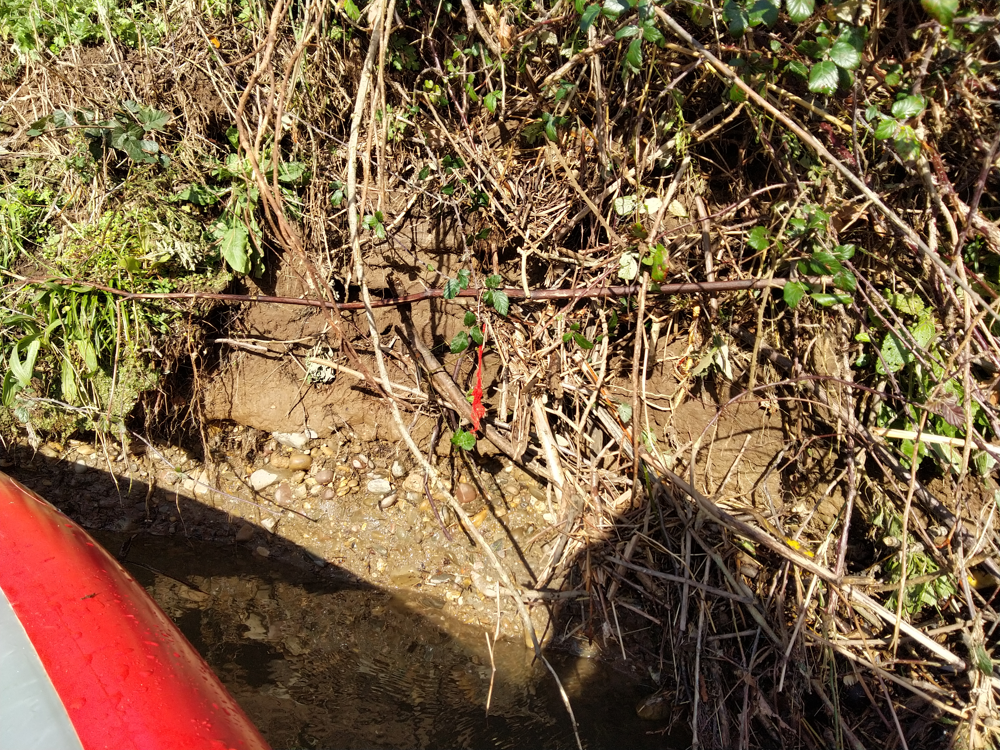

In [42]:
testing_bbox = Image.open(Path("images2label") / name_test_img )
testing_bbox

In [43]:
testing_bbox.size

(4000, 3000)

In [38]:
# testing_bbox    = np.array(testing_bbox)
# h, w     = testing_bbox.shape[:-1]
# target_h = 1080 # the target height of the testing_bbox
# ratio    = target_h / h # We get the ratio of the target and the actual height
# target_w = int(ratio*w)
# testing_bbox    = cv2.resize(testing_bbox, (target_w, target_h))
# print(type(testing_bbox))
# h, w     = testing_bbox.shape[:-1]
# print("New heigth : ",h)
# print("New width : ",h)

In [44]:
id_creator = df_images[df_images["filename"] == name_test_img]["id_creator_fk"][0]
id_creator

'954dfaf0-cf84-4e5d-ad9d-0d0d6badb884'

In [45]:
id_ref_img = df_bboxes[df_bboxes["id_creator_fk"] == id_creator]["id_ref_images_for_labelling"]
id_ref_img = id_ref_img[row_index]
id_ref_img

'9711e35b-67c3-4e76-a5e3-2f7a7204be79'

In [46]:
anns = df_bboxes[df_bboxes["id_ref_images_for_labelling"] == id_ref_img]
anns

,id,id_creator_fk,createdon,id_ref_trash_type_fk,id_ref_images_for_labelling,location_x,location_y,width,height
1,94164dac-8b99-4fa3-9309-cd6ccbbe855e,954dfaf0-cf84-4e5d-ad9d-0d0d6badb884,2021-06-03 15:35:30.492,10,9711e35b-67c3-4e76-a5e3-2f7a7204be79,1489,2330,152,162


In [47]:
target_h = 1080
W = testing_bbox.size[0]
H = testing_bbox.size[1]
testing_our_bboxe = process_annotations(anns, target_h/H, target_h, target_h*W/H)
testing_our_bboxe

(array([9], dtype=int64),
 array([[0.39125   , 0.80366667, 0.038     , 0.054     ]]))

In [48]:
testing_our_array = []
labels = testing_our_bboxe[0]
for i in range(len(labels)):
    temp = [labels[i]]
    bb = testing_our_bboxe[1][i]
    for j in range(len(bb)):
        temp.append(bb[j])
    testing_our_array.append(temp)
testing_our_array

[[9, 0.39125, 0.8036666666666666, 0.038, 0.054]]

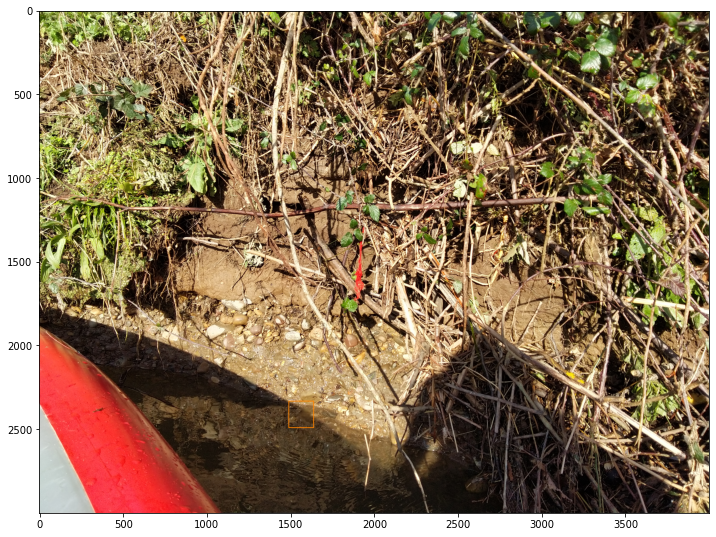

In [49]:
plot_image_an_bboxes_yolo(testing_bbox, testing_our_array)

### TEST 1 - Filtrage

#### (**Ne pas executer !**) 

A exécuter une seule fois et ensuite commenter la ligne ci-dessous car nous chargerons les résultats dans des fichiers pickle et il n'y a pas besoin de relancer les calculs par la suite. (prend 15 min)
Dans la fonction "build_yolo_annoations_for_images", une erreur sur l'orientation a été corrigée.

In [15]:
#yolo_filelist, cpos, cneg = build_yolo_annotations_for_images(args.data_dir, args.images_dir,df_bboxes, df_images, args.limit_data)

number of images in images folder: 7541
number of images referenced in database: 7484
number of images with a bbox in database: 6161
Exists :  500
Missing :  0
Exists :  1000
Missing :  0
Exists :  1500
Missing :  0
Exists :  2000
Missing :  0
Exists :  2500
Missing :  0
Exists :  3000
Missing :  0
Exists :  3500
Missing :  0
Exists :  4000
Missing :  0
Exists :  4500
Missing :  0
Exists :  5000
Missing :  0
Exists :  5500
Missing :  0
Exists :  6000
Missing :  0


In [16]:
# print(len(yolo_filelist))
# print(cpos)
# print(cneg)

6161
6161
0


In [18]:
input_img_folder = Path("images")
list_imgs = sorted(os.listdir(input_img_folder))
print(len(list_imgs))

6161


In [19]:
input_label_folder = Path("labels")
list_labels = sorted(os.listdir(input_label_folder))
print(len(list_labels))

6161


In [20]:
infos_img_with_bboxes = dict()
for i in range(len(list_labels)):
    with open(input_label_folder / list_labels[i]) as file:
        lines = file.readlines()
        L= []
        for line in lines:
            line = line.split()
            L.append([int(line[0])] + list(map(float,line[1:])))

    infos_img_with_bboxes[list_imgs[i]] = L
        

In [21]:
print(len(infos_img_with_bboxes))

6161


#### Infos pickle

La cellule du dessous est à commenter une fois les données écrites dans le fichier pickle. Il suffira juste de les load avec la cellule suivante.

In [50]:
import pickle
PATH_pickle = Path("pickle")

In [23]:
# save the data into a pickle file
# with open(PATH_pickle / 'imgs_with_bboxes.pickle', 'wb') as file_test:
#     pickle.dump(infos_img_with_bboxes,file_test, protocol=pickle.HIGHEST_PROTOCOL)

In [51]:
# load the data from a pickle file
with open(PATH_pickle / 'imgs_with_bboxes.pickle', 'rb') as file_test:
    infos_img_with_bboxes  = pickle.load(file_test)

#### Bugs pickle

In [55]:
# on cherche les images pour lesquelles on a des positions > 1
bugs = []
already_seen = []
for img_name in infos_img_with_bboxes:
    list_bbl = infos_img_with_bboxes[img_name]
    for j in range(len(list_bbl)):
        if img_name in already_seen:
            break
        for pos in list_bbl[j][1:]:
            if pos>1:
                bugs.append((img_name, list_bbl))
                already_seen.append(img_name)
                break

In [56]:
print(len(bugs))
print(bugs[0])

11
('0f81f34a-17b7-4dd9-a98d-cb5ec127ada3.jpg', [[0, 0.33747453022413404, 0.3239087301587302, 0.11716096898347295, 0.02728174603174603], [8, 0.40624292506225945, 0.48921130952380953, 0.2046071994566448, 0.15252976190476192], [7, 0.5083342766583654, 0.06460813492063491, 1.0149705682589993, 0.12524801587301587]])


La cellule du dessous est à commenter une fois les données écrites dans le fichier pickle. Il suffira juste de les load avec la cellule suivante.

In [27]:
# save the data into a pickle file
# with open(PATH_pickle / 'bugs_imgs_with_bboxes.pickle', 'wb') as file_bugs:
#     pickle.dump(bugs,file_bugs, protocol=pickle.HIGHEST_PROTOCOL)

In [52]:
# load the data from a pickle file
with open(PATH_pickle / 'bugs_imgs_with_bboxes.pickle', 'rb') as file_bugs:
    bugs  = pickle.load(file_bugs)

In [53]:
len(bugs)

11

#### Orientation tests

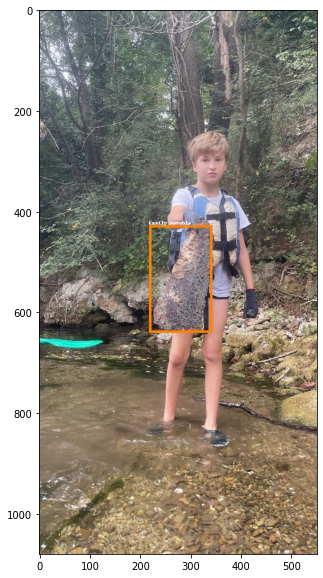

In [32]:
img_name = "ca725c72-fed5-4228-bd40-79a8c639fa60.jpg"
filepath = Path("images") / img_name
bboxes = infos_img_with_bboxes[img_name]
plot_image_an_bboxes_yolo(Image.open(filepath), bboxes)

In [34]:
image=Image.open(filepath)
for orientation in ExifTags.TAGS.keys():
    if ExifTags.TAGS[orientation]=='Orientation':
        print('break')
        break
print(image._getexif())

break
None


#### Plot tests

**All**

In [57]:
# liste images sans bugs
list_img_key = list(set(infos_img_with_bboxes.keys()) - set(already_seen))
print(len(list_img_key))

6150


01719678-d8c7-40b3-a78e-0f04c6b6735b.jpg


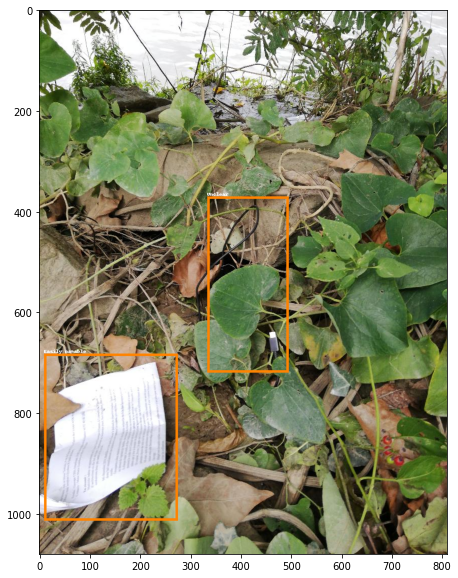

16dee562-7bcb-79e6-0c68-5e6f6060956f.jpg


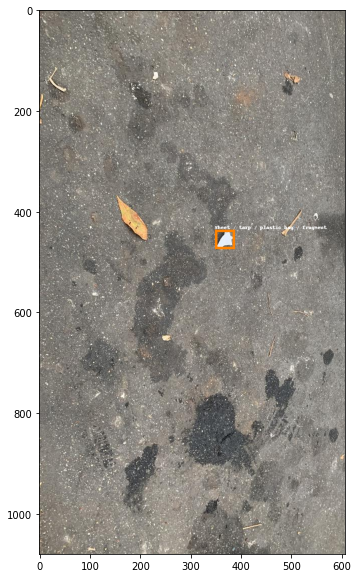

2712aa64-5283-40be-9166-6664ebd19c51.jpg


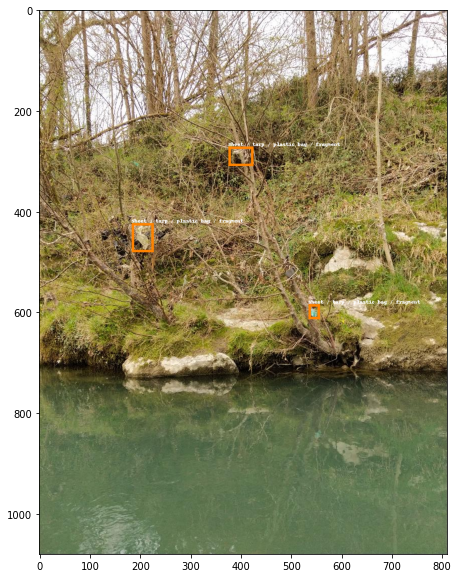

f0758d5e-71d6-4ae4-a563-38601d6351c1.jpg


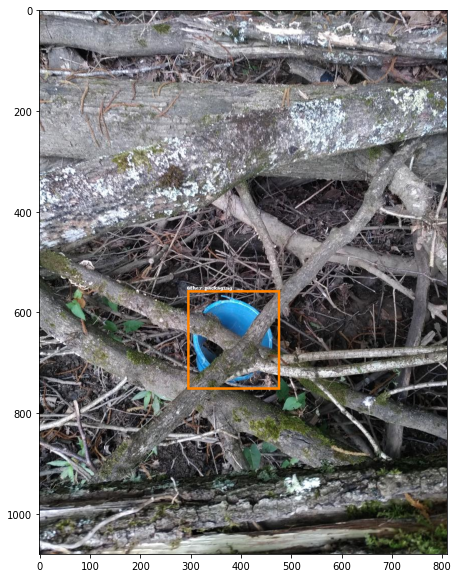

99e7f156-2bd0-537c-2e93-743d21038cbc.jpg


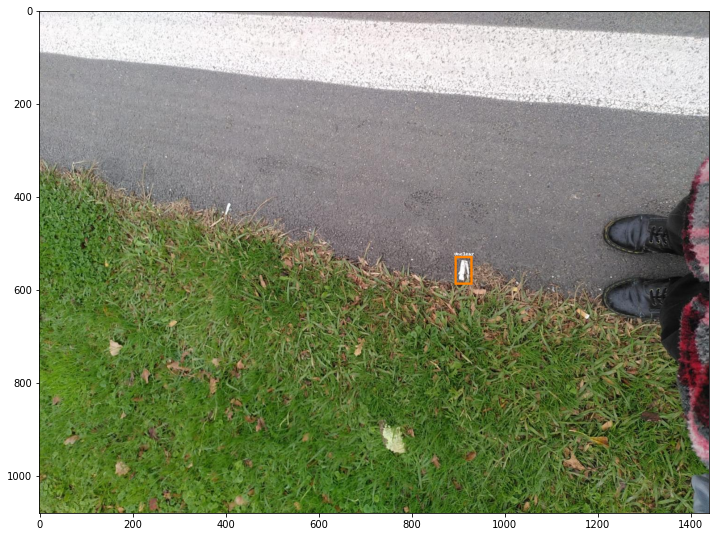

5d2b71e8-e2e3-432a-b7c4-693848e6e741.jpg


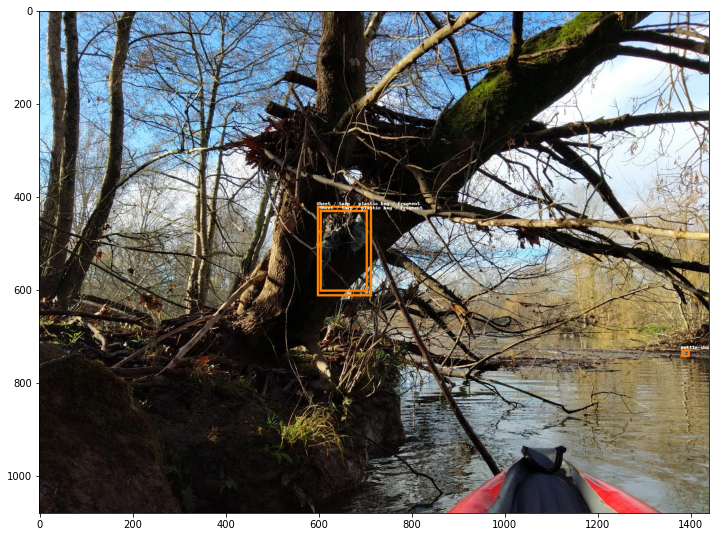

744093fe-3112-4577-abf9-6ec24fa1d66e.jpg


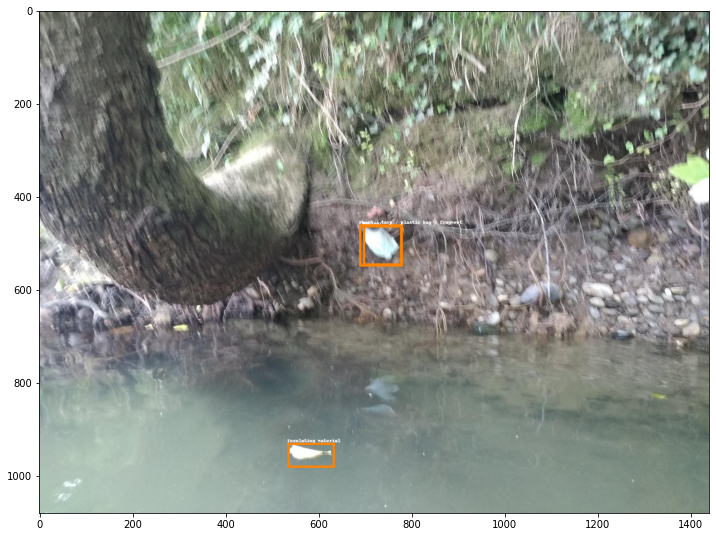

6ffc278d-261a-4609-618f-75b3c3918a77.jpg


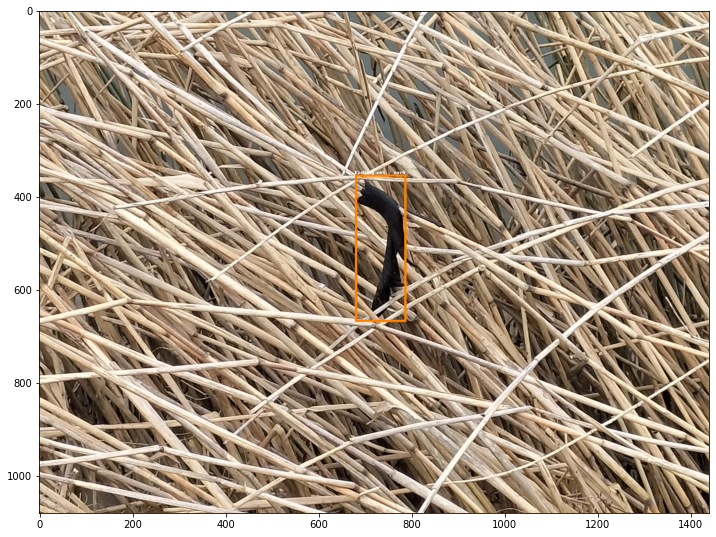

b9c341c0-81f5-111a-970f-1448eca477d9.jpg


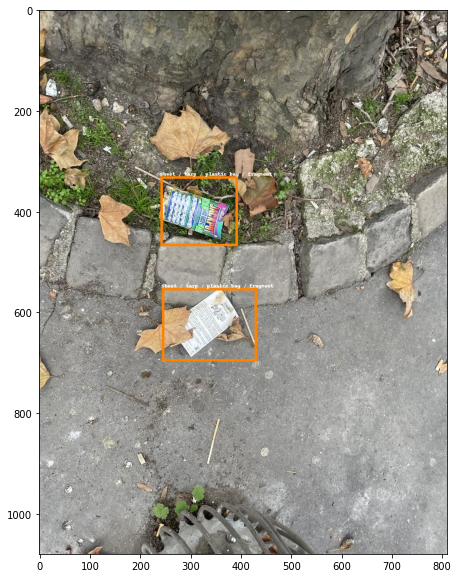

1467f461-1a6a-45d3-8ab1-705389285ad8.jpg


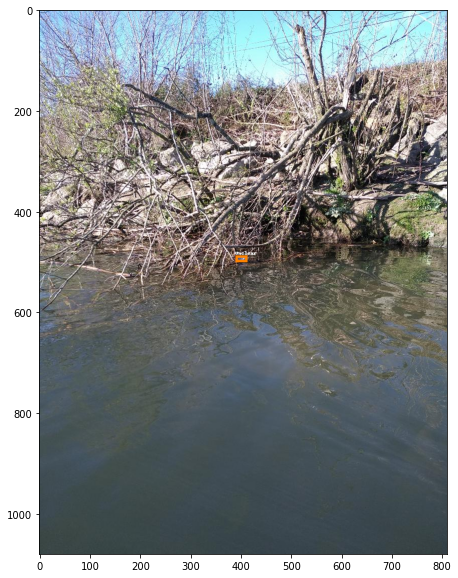

In [68]:
N_min=0
N_max=10
for img_name in list_img_key[N_min:N_max]:
    bboxes = infos_img_with_bboxes[img_name]
    print(img_name)
    plot_image_an_bboxes_yolo(Image.open(Path("images") / img_name), bboxes)
    

**BUGS**

0f81f34a-17b7-4dd9-a98d-cb5ec127ada3.jpg


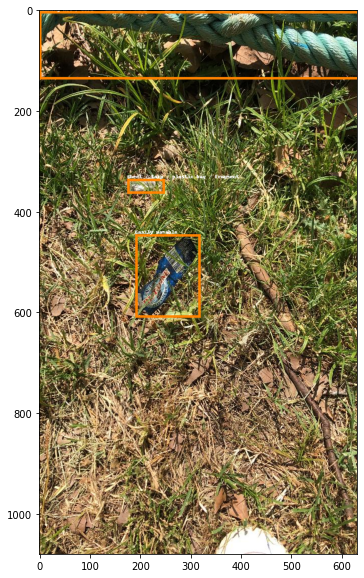

[[0, 0.33747453022413404, 0.3239087301587302, 0.11716096898347295, 0.02728174603174603], [8, 0.40624292506225945, 0.48921130952380953, 0.2046071994566448, 0.15252976190476192], [7, 0.5083342766583654, 0.06460813492063491, 1.0149705682589993, 0.12524801587301587]]
23ac5385-6db3-4281-a91d-4ec7fe743791.jpg


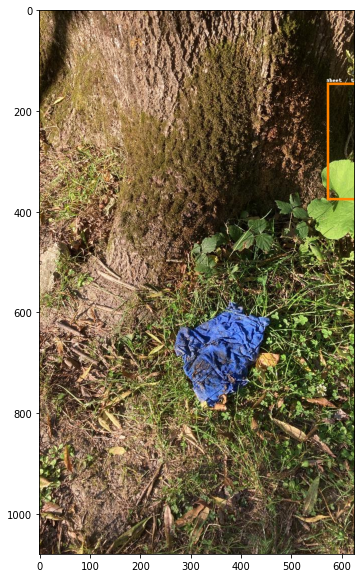

[[0, 1.0968878366042902, 0.24156746031746032, 0.3709778639890461, 0.2152777777777778]]
2b3fe6aa-5feb-4e11-8d6a-876b0222b568.jpg


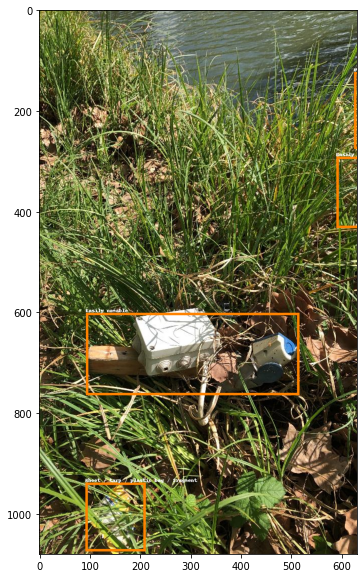

[[0, 0.2409016300656554, 0.931671626984127, 0.18974983020149422, 0.12574404761904762], [8, 0.4839257414534752, 0.6324404761904762, 0.6707040978039394, 0.15128968253968253], [8, 1.0408648403894047, 0.33531746031746035, 0.21055014715870501, 0.13095238095238093], [9, 1.1089964908308807, 0.18452380952380953, 0.23644441928911022, 0.14037698412698413]]
37f3b0bb-5e13-449c-a0a2-bb54d6c12657.jpg


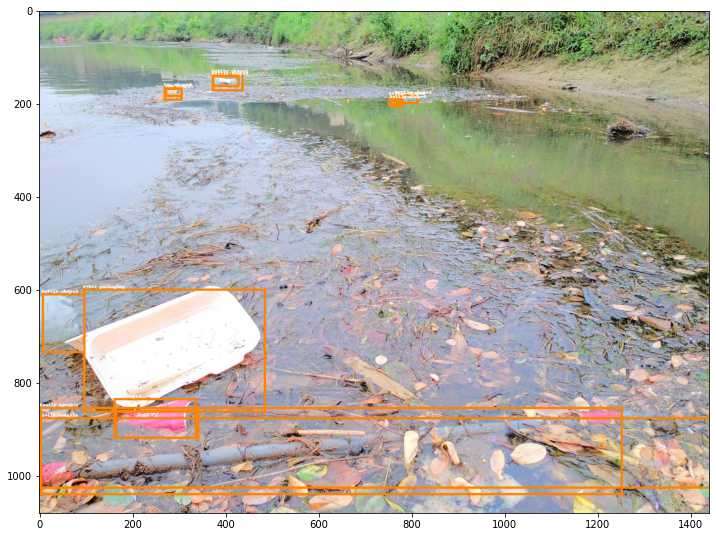

[[2, 0.036875, 0.623, 0.06475, 0.11866666666666667], [3, 0.17662499999999998, 0.8236666666666667, 0.12575, 0.058], [3, 0.2005, 0.16616666666666668, 0.0275, 0.027], [5, 0.20249999999999996, 0.6769999999999999, 0.27249999999999996, 0.246], [8, 0.5313749999999999, 0.8803333333333332, 1.06225, 0.142], [2, 0.54925, 0.177, 0.033499999999999995, 0.018666666666666668], [2, 0.531875, 0.17916666666666664, 0.01925, 0.017666666666666664], [2, 0.28162499999999996, 0.14383333333333334, 0.047749999999999994, 0.036333333333333336], [3, 0.173625, 0.8118333333333333, 0.12424999999999999, 0.08099999999999999], [3, 0.201375, 0.164, 0.02575, 0.018], [8, 0.43649999999999994, 0.8766666666666667, 0.8689999999999999, 0.17466666666666666], [2, 0.533875, 0.18466666666666665, 0.02025, 0.016], [2, 0.27899999999999997, 0.1413333333333333, 0.0405, 0.023333333333333334]]
42a26fe6-d2a5-4c6b-a803-dcb03387f1eb.jpg


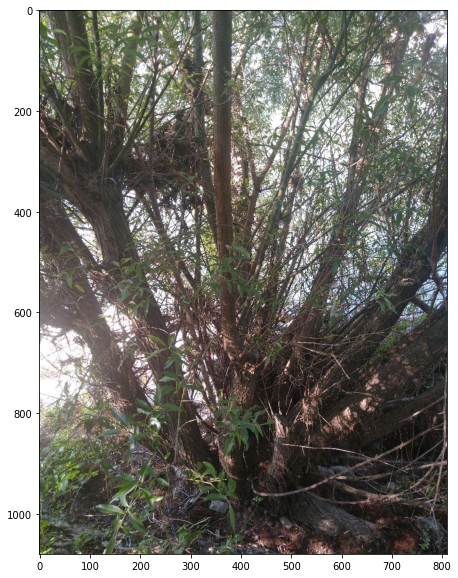

[[9, 1.2193287037037037, 0.4187282986111111, 0.03530092592592592, 0.035807291666666664]]
55df71ed-24d1-49ad-b793-bdc0d17fa097.jpg


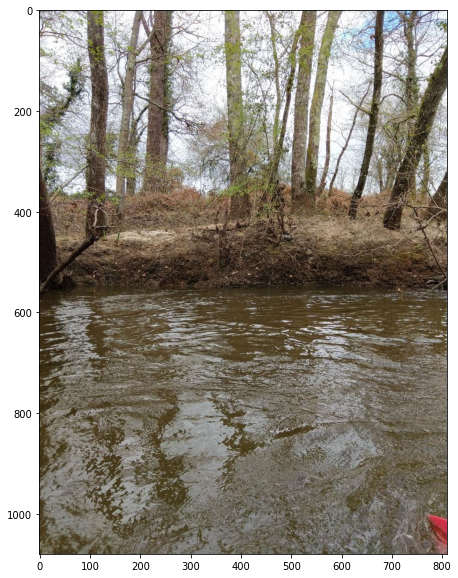

[[0, 1.284, 0.021500000000000002, 0.09733333333333334, 0.041]]
5fd43265-b063-446b-85d9-7618665c21ef.jpg


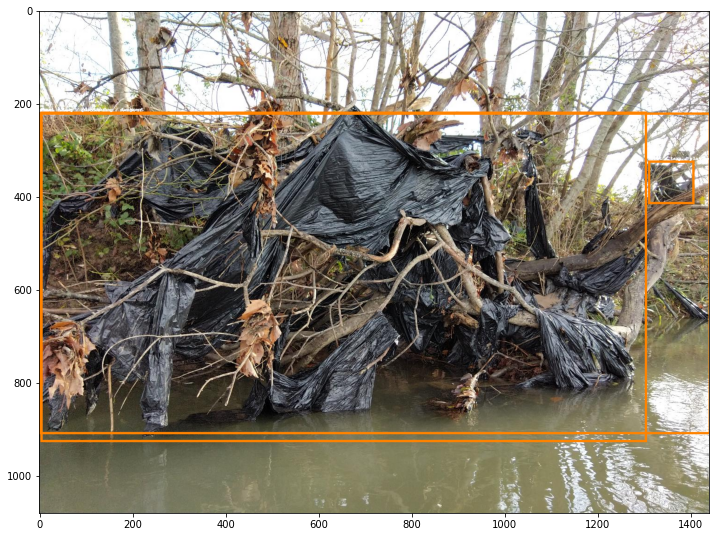

[[0, 0.5015, 0.5236666666666666, 1.0025, 0.6393333333333333], [0, 0.9438750000000001, 0.3426666666666666, 0.06875, 0.08666666666666666], [0, 0.45475, 0.5306666666666666, 0.9045, 0.6566666666666666]]
75bf1655-4705-4ffe-9061-9dde1ada7e56.jpg


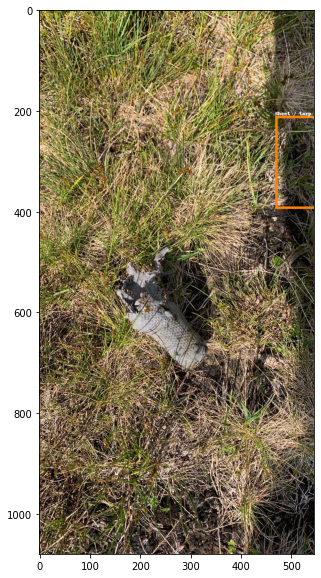

[[0, 1.0863912872841444, 0.28000992063492064, 0.4547684458398744, 0.16964285714285715]]
836162ca-96ae-4493-aad7-3c190c13cb57.jpg


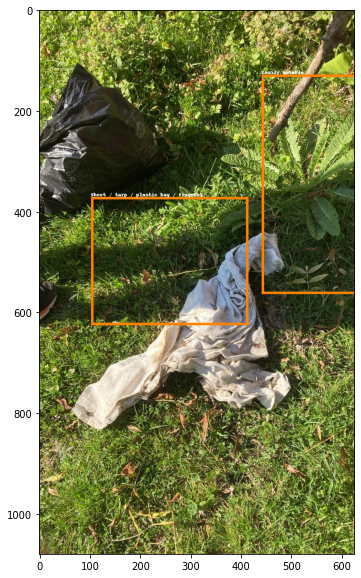

[[8, 1.017942720219078, 0.3205605158730158, 0.6247147421268827, 0.4030257936507936], [0, 0.41333865814696485, 0.46180555555555547, 0.4972044728434505, 0.23561507936507933]]
9dee8abc-18ce-47d3-b3d1-9853a3039171.jpg


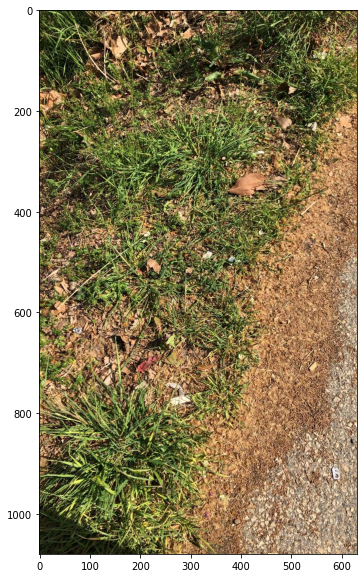

[[3, 1.4598426533846502, 0.039558531746031744, 0.03990264885669006, 0.015625]]
e7cb8d3d-01cc-4906-8c22-c6421474ba44.jpg


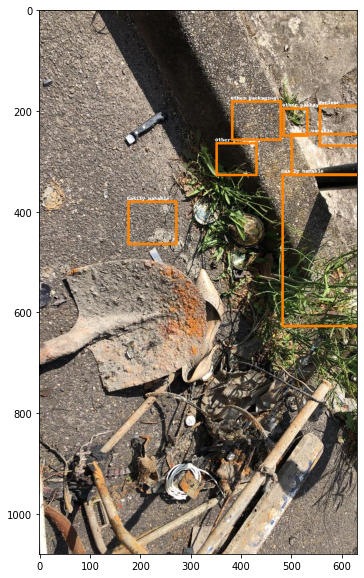

[[9, 1.251627235680326, 0.22085813492063494, 0.22286053882725831, 0.08854166666666667], [8, 0.35636461399139685, 0.3911210317460318, 0.15748811410459587, 0.0818452380952381], [8, 0.9867415666742132, 0.4418402777777778, 0.44869255150554677, 0.2819940476190476], [5, 0.6212502829975096, 0.2743055555555555, 0.1320183382386235, 0.06200396825396825], [9, 1.2329494000452794, 0.02976190476190476, 0.0785318089200815, 0.05853174603174603], [8, 1.4093275979171382, 0.23003472222222224, 0.03735567127009282, 0.026537698412698412], [8, 1.2970483359746434, 0.3043154761904762, 0.05306203305410912, 0.025297619047619044], [8, 0.9945947475662213, 0.265625, 0.40581842879782654, 0.07936507936507936], [5, 0.6834389857369255, 0.2030009920634921, 0.15791261036902873, 0.07366071428571429], [9, 1.535190740321485, 0.12698412698412698, 0.33662553769526826, 0.16815476190476192], [8, 1.484038940457324, 0.3157242063492064, 0.1519696626669685, 0.0873015873015873], [9, 1.4653611048222774, 0.48772321428571425, 0.2012112

In [67]:
list_name_bugs = []
for i in range(len(bugs)):
    bug_name = bugs[i][0]
    list_name_bugs.append(bug_name)
    print(bug_name)
    plot_image_an_bboxes_yolo(Image.open(Path("images") / bug_name), bugs[i][1])
    print(bugs[i][1])